In [2]:
from pathlib import Path
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import numpy as np
import openslide as os
import pandas as pd

In [3]:
def annot_mask(slide_name):
    # Annotation mask
    Image.MAX_IMAGE_PIXELS = None
    im_annot_fn = Path('/home/matejg/Project/crc_ml/data/interim/Prostata/level2/masks/annotations/{slide_name}.png'.format(slide_name=slide_name))
    if im_annot_fn.exists():
        im_annot = Image.open(str(im_annot_fn))
        #plt.imshow(im_annot, cmap=plt.get_cmap('gray'), vmin=0, vmax=255)
        return im_annot
    else:
        print('[WARNING] Annotation does not exist.')
        return None

In [4]:
# Initial BG Mask
def bg_init(slide_name):
    Image.MAX_IMAGE_PIXELS = None
    im_bg_init_fn = Path('/home/matejg/Project/crc_ml/data/interim/Prostata/level4/masks/bg_init/{slide_name}-bg-level4-hsv-otsu-disk10-close-open.png'.format(slide_name=slide_name))
    if im_bg_init_fn.exists():
        im_bg_init = Image.open(str(im_bg_init_fn))
        #plt.imshow(im_bg_init, cmap=plt.get_cmap('gray'), vmin=0, vmax=1)
        return im_bg_init
    else:
        print('[WARNING] Background init mask does not exist.')
        print('{} not found.'.format(str(im_bg_init_fn)))
        return None

In [5]:
def bg_annot(slide_name):
    # BG Annotation Edit
    Image.MAX_IMAGE_PIXELS = None
    im_bg_annot_fn = Path('/home/matejg/Project/crc_ml/data/interim/Prostata/level4/masks/bg_annot/{slide_name}.png'.format(slide_name=slide_name))
    if im_bg_annot_fn.exists():
        im_bg_annot = Image.open(str(im_bg_annot_fn))
        #plt.imshow(im_bg_annot, cmap=plt.get_cmap('gray'), vmin=0, vmax=255)
        return im_bg_annot
    else:
        print('[WARNING] Background annotations does not exist.')
        return None

In [6]:
def annot(slide_name):
    # BG Annotation Edit
    Image.MAX_IMAGE_PIXELS = None
    im_annot_fn = Path('/home/matejg/Project/crc_ml/data/interim/Prostata/level2/masks/annotations/{slide_name}.png'.format(slide_name=slide_name))
    if im_annot_fn.exists():
        im_annot = Image.open(str(im_annot_fn))
        #plt.imshow(im_annot, cmap=plt.get_cmap('gray'), vmin=0, vmax=255)
        return im_annot
    else:
        print('[WARNING] Annotation does not exist.')
        return None

In [7]:
def bg_final(slide_name):
    # BG Combined
    Image.MAX_IMAGE_PIXELS = None
    im_mask_fn = Path('/home/matejg/Project/crc_ml/data/interim/Prostata/level4/masks/bg_final/{slide_name}.png'.format(slide_name=slide_name))
    if im_mask_fn.exists():
        im_mask = Image.open(str(im_mask_fn))
        #plt.imshow(im_mask, cmap=plt.get_cmap('gray'), vmin=0, vmax=255)
        return im_mask
    else:
        print('[WARNING] Combined mask does not exist.')
        return None

In [8]:
def show_slide(slide_name):
    residents = [
        Path('/mnt/data/scans/AI scans/Prostata/Prospective test cases/'),
        Path('/mnt/data/scans/AI scans/Prostata/archive negative cases/'),
        Path('/mnt/data/scans/AI scans/Prostata/archive tumor cases/'),
        Path('/mnt/data/camelyon17/training/slides/')
    ]
    SLIDE_FOUND = False
    for resident in residents:
        for suffix in ['.mrxs', '.tif']:
            p = (resident / slide_name).with_suffix(suffix)
            if p.exists():
                SLIDE_FOUND = True
                print('Found: {}'.format(str(resident.name)))
                break
        if SLIDE_FOUND:
            break
    else:
        print('Slide does not exist.')
        return None
    print(str(p))
    slide = os.open_slide(str(p))
    # Raw image scaled
    display_level = 4
    im_raw = slide.read_region((0,0), display_level, slide.level_dimensions[display_level])
    slide.close()
    #plt.imshow(im_raw)
    return im_raw

In [9]:
def show(im):
    plt.imshow(im, cmap=plt.get_cmap('gray'), vmin=0, vmax=255)

Found: Prospective test cases
/mnt/data/scans/AI scans/Prostata/Prospective test cases/TP-2019_2623-12-1.mrxs
[WARNING] Background init mask does not exist.
/home/matejg/Project/crc_ml/data/interim/Prostata/level4/masks/bg_init/TP-2019_2623-12-1-bg-level4-hsv-otsu-disk10-close-open.png not found.
[WARNING] Combined mask does not exist.
[WARNING] Annotation does not exist.


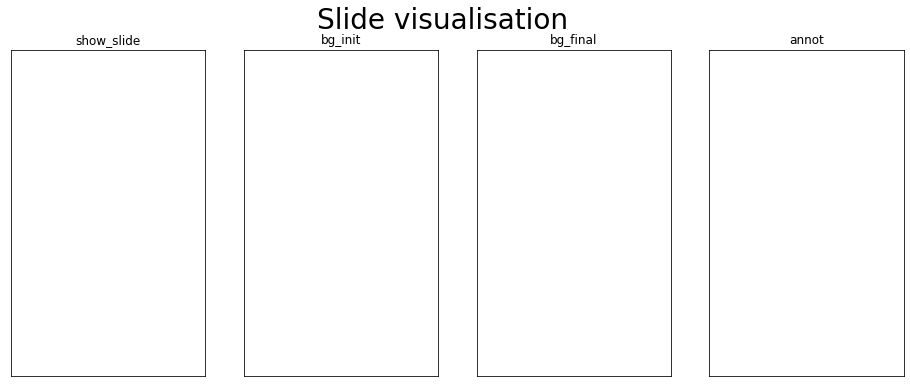

In [10]:
slide_name = 'TP-2019_2623-12-1'

img_fns = [show_slide, bg_init, bg_final, annot]
num_cols = 4
num_rows = 1
title_space = 2
fig = plt.figure(figsize=(4*num_cols, 4*num_rows+title_space))
fig.suptitle('Slide visualisation', fontsize=28)

for idx, img_fn in enumerate(img_fns):   
    ax = fig.add_subplot(num_rows, num_cols, idx+1, xticks=[], yticks=[])
    ax.set_title(img_fn.__name__)
    img = img_fn(slide_name)

In [3]:
slide_name = 'TP-2019_2623-12-1'

In [11]:
aim = annot_mask(slide_name)

In [15]:
sim = show_slide(slide_name)
im = annot_mask(slide_name)

Found: Prospective test cases
/mnt/data/scans/AI scans/Prostata/Prospective test cases/TP-2019_2623-12-1.mrxs
[WARNING] Annotation does not exist.


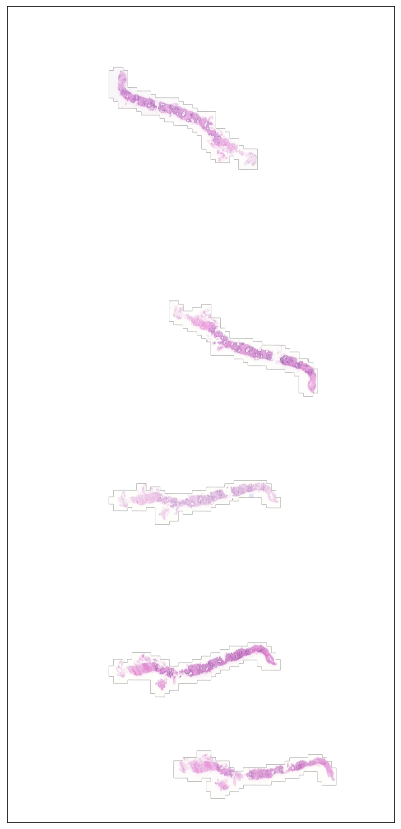

In [13]:
plt.figure(figsize = (15,15))
plt.tick_params(axis='both', bottom=False, top=False, right=False, left=False,
                         labelbottom=False, labelleft=False)
show(sim)

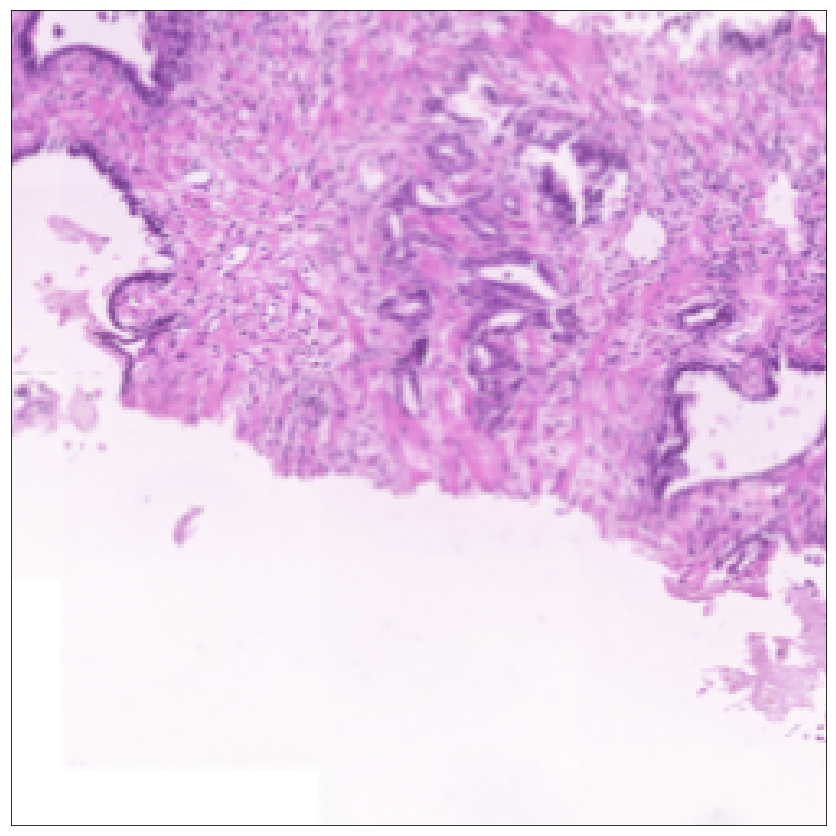

In [29]:
scale=4
x2 = 35000 // (4*scale)
y2 = 25000 // (4*scale)
sx = 4000 // (4*scale)
sy = 4000 // (4*scale)
cim = sim.crop((x2, y2, x2+sx, y2+sy))
plt.figure(figsize = (15,15))
plt.tick_params(axis='both', bottom=False, top=False, right=False, left=False,
                         labelbottom=False, labelleft=False)
plt.imshow(cim)
#show(cim)

In [38]:
oslide = os.open_slide('/mnt/data/scans/AI scans/Prostata/Prospective test cases/TP-2019_2623-12-1.mrxs')
print(oslide.level_dimensions[0])
level = 2
w,h = oslide.level_dimensions[level]

(105185, 221772)


In [40]:
im = oslide.read_region((105185//4,221772//4*3), level=level, size=(w//4*2, h//8))
bg_im = Image.new('RGB', im.size, '#FFFFFF')
bg_im.paste(im, None, im)
bg_im

In [41]:
from skimage import color, filters, morphology
from skimage.color import rgb2hsv

#im = oslide.read_region((105185//4,221772//4*3), level=level, size=(w//4*2, h//8))
im = oslide.read_region((0,0), level=level, size=oslide.level_dimensions[level])
bg_im = Image.new('RGB', im.size, '#FFFFFF')
bg_im.paste(im, None, im)
slide_hsv = color.rgb2hsv(np.array(bg_im))
saturation = slide_hsv[:, :, 1]
threshold = filters.threshold_otsu(saturation)
high_saturation = (saturation > threshold)
disk_object = morphology.disk(10)
mask = morphology.closing(high_saturation, disk_object)
mask = morphology.opening(mask, disk_object)
mask = Image.fromarray(mask)
mask.crop((w//4, h//4*3, (w//4) + (w//4*2), (h//4*3)+(h//8)))

In [39]:
annot_fp = ((Path('/mnt/data/crc_ml/data/interim/Prostata/level2/masks/annotations') / slide_name).with_suffix('.png'))
annot_im = Image.open(annot_fp)
annot_im.crop((w//4, h//4*3, (w//4) + (w//4*2), (h//4*3)+(h//8)))

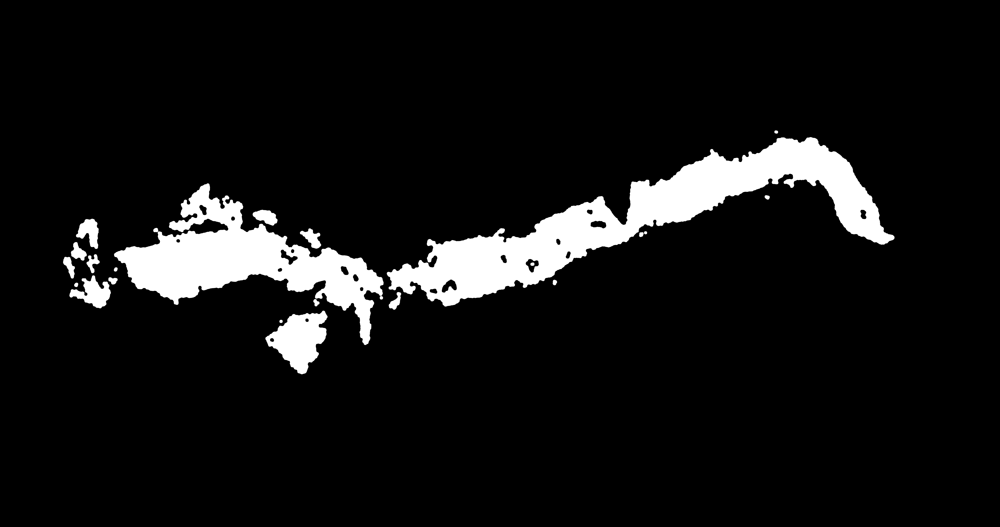